# Table of Contents:
1. [Library Imports](#library-imports)
2. [Data](#data)
3. [Initial Preprocessing](#preproc)
4. [Inconsistencies](#inconsistencies)
5. [Data Visualization](#dataviz)
6. [Column Exclusion](#column-exclusion)
7. [Imputation](#imputation)
8. [Outliers](#outliers)
9. [Feature Engineering](#feature-engineering)
10. [Data Visualization](#dataviz2)
11. [Duvidas](#duvidas)
12. [Descobertas](#descobertas)
13. [Extras](#extras)
14. [IDs](#ids)


# Library Imports
<a id='library-imports'></a>

In [91]:
### BASIC LIBRARIES
# from datetime import datetime
# !pip install numpy
import numpy as np
# !pip install pandas
import pandas as pd

### VISUALIZATION
# !pip install matplotlib
import matplotlib.pyplot as plt
# !pip install seaborn
import seaborn as sns
# !pip install plotly
# import plotly.express as px
# !pip install squarify
# import squarify
from pylab import rcParams
rcParams['figure.figsize'] = 20, 10
# !pip install nbformat>=4.2.0

### SKLEARN
# !pip install scikit-learn
from sklearn.preprocessing import StandardScaler
# from sklearn.impute import KNNImputer
# from sklearn.model_selection import train_test_split
# from sklearn.cluster import KMeans
# from sklearn.metrics import silhouette_score

### WARNINGS
import warnings
warnings.filterwarnings('ignore')

### FUNCTIONS
from utils1 import *

### AUTORELOAD
%load_ext autoreload
%autoreload 2


# Set the path to the data files
# path = "C:\\Users\\ritaf\\Documentos\\Estudos\\NovaIMS\\Mestrado_GIBI\\DM_I\\DM_Project\\"


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Open Data
<a id='data'></a>

In [2]:
data = pd.read_csv('Data\project_data.csv')

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 123683 entries, 0 to 123682
Data columns (total 31 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ID_Client               123354 non-null  object 
 1   Frequency_items         123683 non-null  int64  
 2   Potencial_Score         123683 non-null  float64
 3   ZIP_Code                123089 non-null  object 
 4   Longevity_months        123683 non-null  int64  
 5   Latitude                123683 non-null  float64
 6   Longitude               123683 non-null  float64
 7   Credit_factor           123683 non-null  float64
 8   Relevance_criteria      123683 non-null  object 
 9   Store_state             123683 non-null  object 
 10  Recency_in_weeks        123683 non-null  int64  
 11  Returns                 123683 non-null  int64  
 12  ID_Store_last           123683 non-null  int64  
 13  Gender                  42566 non-null   object 
 14  Flaged              

In [4]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Frequency_items,123683.0,38.261224,13.594001,1.0,29.000000,37.00000,47.000000,131.000000
Potencial_Score,123683.0,30.392316,99.673585,-1.0,0.800000,24.05884,39.701604,11481.040829
Longevity_months,123683.0,13.665354,9.881178,-12.0,6.000000,13.00000,21.000000,45.000000
Latitude,123683.0,25.249363,29.997630,-5.0,-0.166667,1.00000,60.126211,72.170287
Longitude,123683.0,6.158188,7.697199,-5.0,-0.166667,1.00000,13.971501,30.973885
Credit_factor,123683.0,0.899913,0.799920,0.0,0.700000,0.70000,1.000000,28.400000
Recency_in_weeks,123683.0,11.244706,3.799946,-4.0,9.000000,11.00000,14.000000,18.000000
Returns,123683.0,4.310972,27.629597,-87.0,0.000000,0.00000,0.000000,591.000000
ID_Store_last,123683.0,1.000000,0.000000,1.0,1.000000,1.00000,1.000000,1.000000
Flaged,123683.0,0.010373,0.101639,0.0,0.000000,0.00000,0.000000,2.000000


# Initial Preprocessing
<a id='preproc'></a>

| Column | NaN | Ws/Unkwn | Outliers | Negs | Ambiguous | Dups | Wrong Type | Notes |
| --- | --- | --- | --- | --- | --- | --- | --- | --- |
| ID_Client | x | x |  |  |  | x |  |  |
| Frequency_items |  |  |  |  |  |  |  |  |
| Potencial_Score |  |  | x | x |  |  |  | Round |
| ZIP_Code | x | x |  |  |  |  | x | Obj -> int |
| Longevity_months |  |  |  | x |  |  |  | Calculated 31/12/2023 |
| Latitude & Longitude |  |  |  |  |  |  |  | Block in Africa |
| Credit_factor |  |  | x |  |  |  |  | Different interpretation |
| Relevance_criteria |  | x |  |  |  |  |  | Might convert to boolean |
| Recency_in_weeks |  |  |  | x |  |  |  | Calculated 31/12/2023 |
| Returns |  |  | x | x | |  |  |  |
| Gender | x |  |  |  | x |  |  | Drop -> too many outliers |
| Flaged |  |  |  |  | x |  | x | Is a bool but has 2s |
| Promotional_percentage |  |  | x | x |  |  |  |  |
| Education | x | x |  |  | x |  |  | Drop -> too many outliers |
| Beer |  |  | x |  |  |  |  |  |
| Bottled_Water |  |  | x |  |  |  |  |  |
| Dairy |  |  | x |  |  |  | x | Obj -> int |
| Fresh_Foods |  |  | x | x |  |  |  |  |
| Frozen_Foods | x |  | x | x |  |  |  |  |
| Fruit_Beverages |  |  | x | x |  |  |  |  |
| Pastry |  |  | x |  |  |  |  |  |
| Sodas |  |  | x | x |  |  |  |  |
| Toiletries |  |  | x | x |  |  |  |  |
| Veggies |  |  | x | x |  |  |  |  |
| Wines |  |  | x | x |  |  |  |  |
| ID_Store_last |  |  |  |  |  |  |  | Constant |
| Checked_ok |  |  |  |  |  |  |  | Constant |
| Store_state |  |  |  |  |  |  |  | Constant |

### Constant Columns

In [5]:
# Droping constant columns
data.drop(columns=['ID_Store_last', 'Checked_ok', 'Store_state'], inplace=True)

### Set Missing Values

In [6]:
# Setting up missing values as NaN
data['ID_Client'].replace(' ', np.nan, inplace=True)
data['ZIP_Code'].replace('  ', np.nan, inplace=True) # 1% of NaN
data['Relevance_criteria'].replace('Unknown', np.nan, inplace=True) # 1,7% of NaN
data['Gender'].replace({'    ': np.nan, 'm': np.nan, 'mm': np.nan, 'j': np.nan}, inplace=True) # 73% of NaN
data['Education'].replace(' ', np.nan, inplace=True) # 42% of NaN -> possivel imputar com NumID!

### Correct Values

In [7]:
# Correcting ambiguity
data['Gender'].replace({'Female': 'female'}, inplace=True) # 73% of NaN
data['Education'].replace({'High School ': 'High School', 'Bachelor Degree': 'BSc Degree'}, inplace=True) # 42% of NaN -> possivel imputar com NumID!

### DataType Correction

In [8]:
# Categorical to numerical
data['ZIP_Code'] = data['ZIP_Code'].astype(float)

dairy_values = data['Dairy'].str.split(',', expand=True)
dairy_values[1] = dairy_values[1].astype(float)
if (dairy_values[1] != 0).any():
    data['Dairy'] = data['Dairy'].str.replace(',', '.').astype(float)
else:
    data['Dairy'] = data['Dairy'].str.replace(',000', '').astype(int)

# Float to Integer
if ((data['Toiletries'].dropna() % 1 == 0).all()):
    data['Toiletries'] = data['Toiletries'].fillna(1000).astype(int)
    data['Toiletries'] = data['Toiletries'].replace(1000, np.nan) # no missing values


### Encoding

In [9]:
data['Relevance_criteria'] = data['Relevance_criteria'].replace({'Priority': 1, 'Caution': 0})
data['Gender'] = data['Gender'].replace({'male': 1, 'female': 0})
data['Education'] = data['Education'].replace({'High School': 1, 'Degree': 2, 'BSc Degree': 3, 'MSc Degree': 4})

### Other Transformations

In [10]:
data['Potencial_Score'] = data['Potencial_Score'].round(2)

# Inconsistencies
<a id='inconsistencies'></a>

### Flagged

In [11]:
data['Flaged'].replace(2, np.nan, inplace=True) # ~0% of NaN - VAI SER PRECISO CORRIGIR DATATYPES DEPOIS DE IMPUTAR (FICOU FLOAT POR CAUSSA DE NAN)

### Returns & Spent Amounts

In [12]:
spent_amounts = ['Beer', 'Bottled_Water', 'Bread', 'Meat', 'Dairy', 'Fresh_Foods', 'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 'Toiletries', 'Veggies', 'Wines']

In [13]:
# # SET INCONSISTENT VALUES OF RETURNS AS NaN
# spent_amounts = ['Beer', 'Bottled_Water', 'Bread', 'Meat', 'Dairy', 'Fresh_Foods', 'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 'Toiletries', 'Veggies', 'Wines']

# # Identify rows where Returns are 0 and there are negative values in any of the spent_amounts columns
# rows_with_neg_values = data[(data['Returns'] == 0) & (data[spent_amounts] < 0).any(axis=1)]

# # Iterate over these rows and update the Returns column and negative values
# for index, row in rows_with_neg_values.iterrows():
#     data.at[index, 'Returns'] = np.nan

# # Check percentage of Returns Missing Values
# print(f'Number of inconsistencies: {rows_with_neg_values.shape[0]}')
# print(f"Current percentage Returns' null values: {round(data[data['Returns'].isnull()].shape[0] / 123683 * 100, 2)}%")

### Negative Values

Spent Amounts & Promotional Percentage

In [14]:
# Percentage of negative values in each spent amounts column
spent_amounts.append('Promotional_percentage')

# Create a DataFrame to store the results
negative_percentage_df = pd.DataFrame()

# Add the negative percentage data for each dataset
negative_percentage_df['%Neg Values'] = round((((data[spent_amounts] < 0).sum()) / data.shape[0]) * 100, 2)
spent_amounts.remove('Promotional_percentage')

# Transpose the DataFrame for better readability
# negative_percentage_df = negative_percentage_df.T

# Filter out columns with zero percentage
# negative_percentage_df = negative_percentage_df.loc[:, (negative_percentage_df != 0).any(axis=0)] # for transposed DataFrame
negative_percentage_df = negative_percentage_df.loc[(negative_percentage_df != 0).any(axis=1), :]

# Sort values
negative_percentage_df = negative_percentage_df.sort_values(by='%Neg Values', ascending=False)

# Display the DataFrame
negative_percentage_df

,%Neg Values
Wines,13.64
Veggies,12.60
Sodas,11.70
Toiletries,3.85
Promotional_percentage,1.17
Fruit_Beverages,1.04
Fresh_Foods,0.95
Frozen_Foods,0.89
Meat,0.06


In [15]:
# Set negative spent amounts and promotional percentage to 0
data[spent_amounts] = data[spent_amounts].applymap(lambda x: max(x, 0))
data['Promotional_percentage'] = data['Promotional_percentage'].apply(lambda x: max(x, 0))

Returns, Recency & Longevity

In [16]:
# Change the recency baseline date to 4 weeks later
data['Recency_in_weeks'] = data['Recency_in_weeks'] + 4 

In [17]:
# SET NEGATIVE VALUES IN RETURNS AND LONGEVITY AS NaN TO BE IMPUTED LATER
inconsistent_neg_cols = ['Returns', 'Longevity_months']
for col in inconsistent_neg_cols:
    data[col] = data[col].apply(lambda x: np.nan if x < 0 else x)

### Missing Values

In [18]:
missing_percentage = data.isnull().mean() * 100
missing_percentage = missing_percentage[missing_percentage > 0].sort_values(ascending=False)
missing_percentage

Gender                72.847521
Education             42.154540
Longevity_months       7.945312
Relevance_criteria     1.679293
Returns                1.667974
ZIP_Code               1.021967
Frozen_Foods           0.506133
ID_Client              0.498856
Flaged                 0.003234
dtype: float64

# Data Visualization
<a id='dataviz'></a>

### Ranges

In [19]:
numeric_columns = ['Potencial_Score', 'Credit_factor', 'Returns', 'Promotional_percentage', 'Beer', 'Bottled_Water', 
                   'Bread', 'Meat', 'Dairy', 'Fresh_Foods', 'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 
                   'Toiletries', 'Veggies', 'Wines']
categorical_columns = ['Frequency_items', 'Longevity_months', 'Recency_in_weeks', 'Education',
                       'ZIP_Code','Gender', 'Relevance_criteria', 'Flaged']

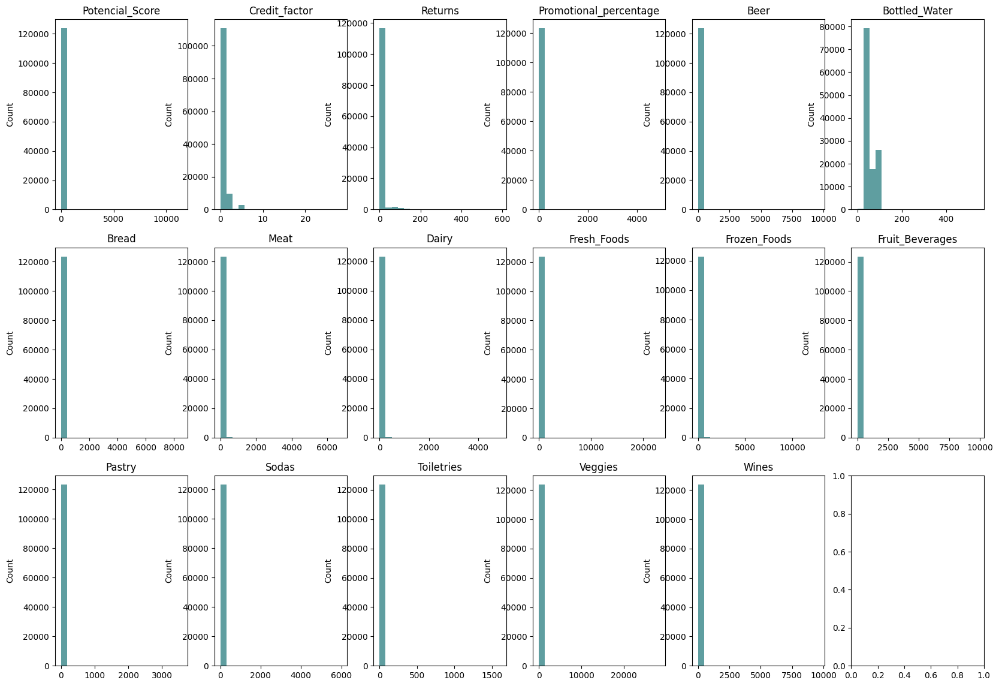

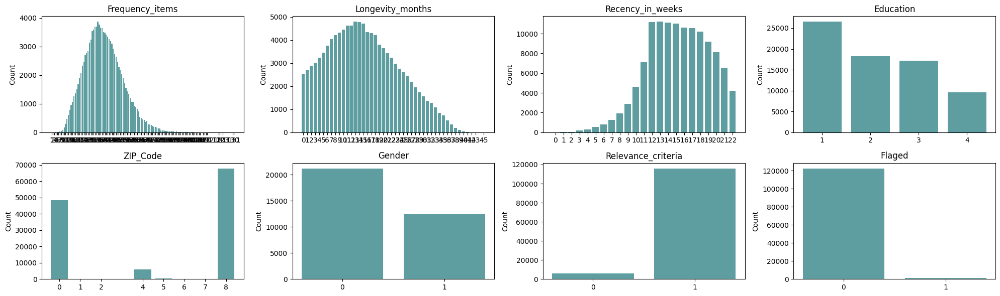

In [20]:
fig_hist, axs_hist = plt.subplots(nrows=3, ncols=6, figsize=(20, 14))
axs_hist = axs_hist.flatten()

fig_bar, axs_bar = plt.subplots(nrows=2, ncols=4, figsize=(20, 6))
axs_bar = axs_bar.flatten()

for i, col in enumerate(numeric_columns):
    plot_histogram(axs_hist[i], data, col, '')
    axs_hist[i].set_title(col)

for i, col in enumerate(categorical_columns):
    plot_bar_chart(axs_bar[i], data, col, '')
    axs_bar[i].set_title(col)

plt.tight_layout()
plt.show()


It is clear that the numeric columns have outliers

### Maps

In [21]:
# Sort the DataFrame by the frequency of ZIP_Code
data['ZIP_Code'] = pd.Categorical(data['ZIP_Code'], categories=data['ZIP_Code'].value_counts().index, ordered=True)
data_sorted = data.sort_values('ZIP_Code')

print('Normal Coordinates')
plot_map(data_sorted, 'ZIP_Code', 'ID_Client', 1.2)
print('Inverted Coordinates')
plot_map(data_sorted, 'ZIP_Code', 'ID_Client', 1.6, invert=True)

Normal Coordinates


Inverted Coordinates


Coordinate data has a lot of generated values and Zip Code is not geographicaly representative with these coordinates

### Correlation

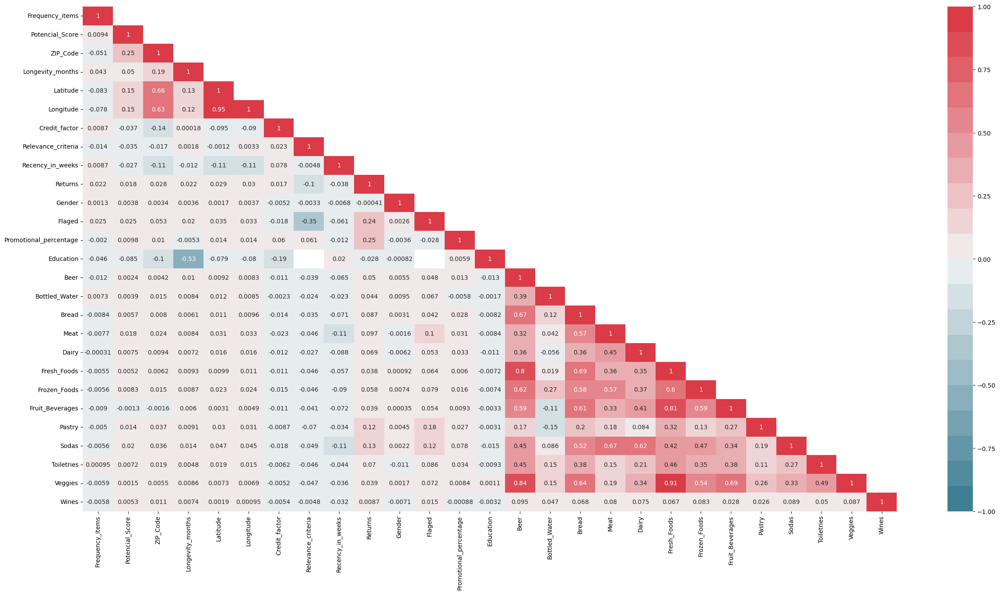

In [22]:
plot_correlation_matrix(data.iloc[:, 1:], 'pearson')

# Column Exclusion
<a id='column-exclusion'></a>

Create a copy of the data before dropping columns

In [23]:
data_copy = data.copy()

### Missing values
Eliminating columns with an elevated amount of missing values

In [24]:
# Calculate the threshold for 30% NaNs
threshold = len(data) * 0.30

# Identify columns to drop
columns_to_drop = data.columns[data.isna().sum() > threshold]

# Drop the columns
data.drop(columns=columns_to_drop, inplace=True)

# Print the names of the dropped columns
print("Dropped columns:", columns_to_drop.tolist())

Dropped columns: ['Gender', 'Education']


### Geographical columns
Eliminating coordinates as the majority of the columns values have been generated

In [25]:
data.drop(columns=['Latitude', 'Longitude'], inplace=True)

# Imputation
<a id='imputation'></a>

In [ ]:
#Tenho medo de perder esta celula
knn_imputer_best_k(data, 3, 8)

Best K value: 4


In [26]:
# Initialize KNNImputer with parameters: 4 nearest neighbors and distance weighting
knn_imputer = KNNImputer(n_neighbors=4, weights='distance').fit(data.iloc[:, 1:])

# Impute missing values in 'data' DataFrame and create a new DataFrame 'data_imputed'
data_imputed = pd.DataFrame(knn_imputer.transform(data.iloc[:, 1:]), columns=data.iloc[:, 1:].columns, index=data.iloc[:, 1:].index)

# Insert the 'ID_Client' column at the beginning of the 'data_imputed' DataFrame
data_imputed.insert(0, 'ID_Client', data['ID_Client'])

In [27]:
columns_to_round = ['Longevity_months', 'Relevance_criteria', 'Returns', 'ZIP_Code', 'Frozen_Foods', 'Flaged']

# Round the specified columns and transform them into integers
data_imputed[columns_to_round] = data_imputed[columns_to_round].round()

In [28]:
integer_columns = ['Frequency_items', 'ZIP_Code', 'Longevity_months', 'Relevance_criteria',
       'Recency_in_weeks', 'Returns', 'Flaged', 'Promotional_percentage',
       'Beer', 'Bottled_Water', 'Bread', 'Meat', 'Dairy', 'Fresh_Foods',
       'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 'Toiletries',
       'Veggies', 'Wines']
data_imputed[integer_columns] = data_imputed[integer_columns].astype(int)

In [95]:
# data_imputed.to_csv('Data\project_data_cleaned_noreturnincons_impute4_wzipid.csv', index=False)
data_imputed = pd.read_csv('Data\project_data_cleaned_noreturnincons_impute4_wzipid.csv')

# Outliers
<a id='outliers'></a>

In [96]:
outlier_columns = ['Potencial_Score', 'Credit_factor', 'Returns', 'Promotional_percentage',
       'Beer', 'Bottled_Water', 'Bread', 'Meat', 'Dairy', 'Fresh_Foods',
       'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 'Toiletries',
       'Veggies', 'Wines']

In [97]:
detect_outliers_iqr_with_stats(data_imputed, outlier_columns)

,Lower Bound,Upper Bound,Percentage Outliers
Potencial_Score,-57.55,98.05,0.680773
Credit_factor,0.25,1.45,20.802374
Returns,0.00,0.00,4.591577
Promotional_percentage,-24.00,40.00,6.354956
Beer,-12.50,135.50,0.595878
Bottled_Water,-11.00,133.00,0.124512
Bread,14.50,42.50,10.107290
Meat,0.00,0.00,15.120914
Dairy,-47.00,153.00,0.571623
Fresh_Foods,-80.00,208.00,0.643581


In [98]:
data_no_outliers_iqr = remove_outliers_iqr(data_imputed, outlier_columns)
print(f"Only {data_no_outliers_iqr.shape[0]/data.shape[0]*100:.2f}% of the original data does not contain outliers")

Only 37.77% of the original data does not contain outliers


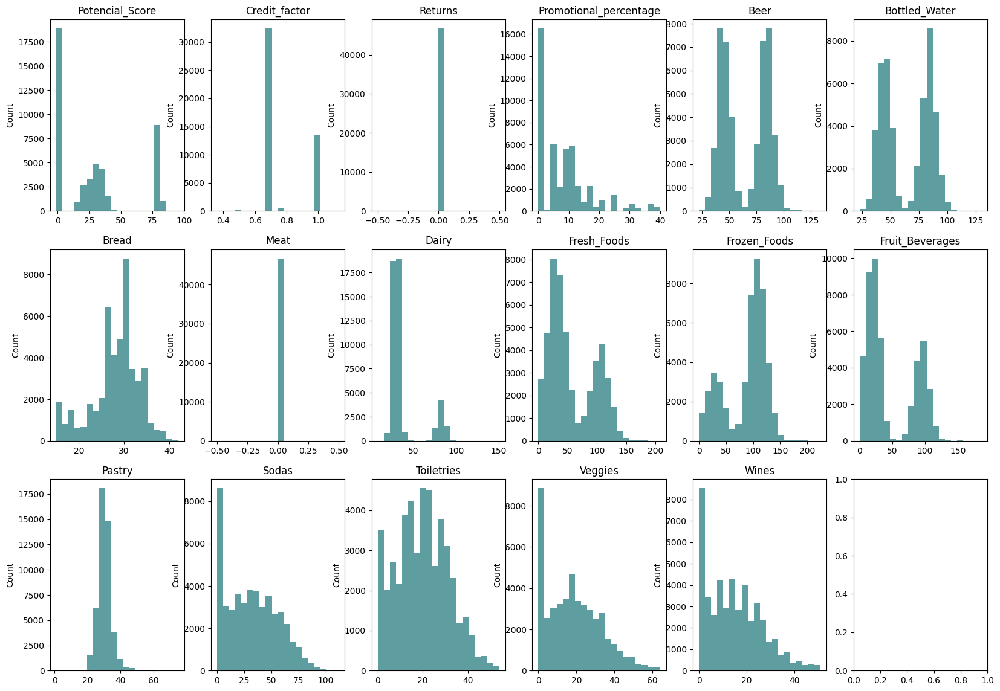

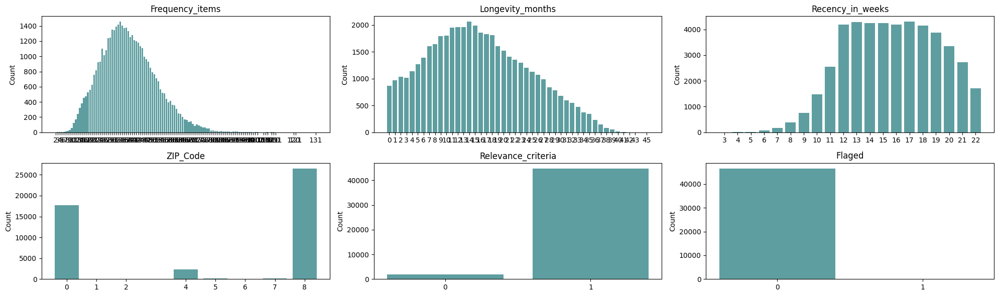

In [ ]:
categorical_columns.remove('Education')
categorical_columns.remove('Gender')

fig_hist, axs_hist = plt.subplots(nrows=3, ncols=6, figsize=(20, 14))
axs_hist = axs_hist.flatten()

fig_bar, axs_bar = plt.subplots(nrows=2, ncols=3, figsize=(20, 6))
axs_bar = axs_bar.flatten()

for i, col in enumerate(numeric_columns):
    plot_histogram(axs_hist[i], data_no_outliers_iqr, col, '')
    axs_hist[i].set_title(col)

for i, col in enumerate(categorical_columns):
    plot_bar_chart(axs_bar[i], data_no_outliers_iqr, col, '')
    axs_bar[i].set_title(col)

plt.tight_layout()
plt.show()


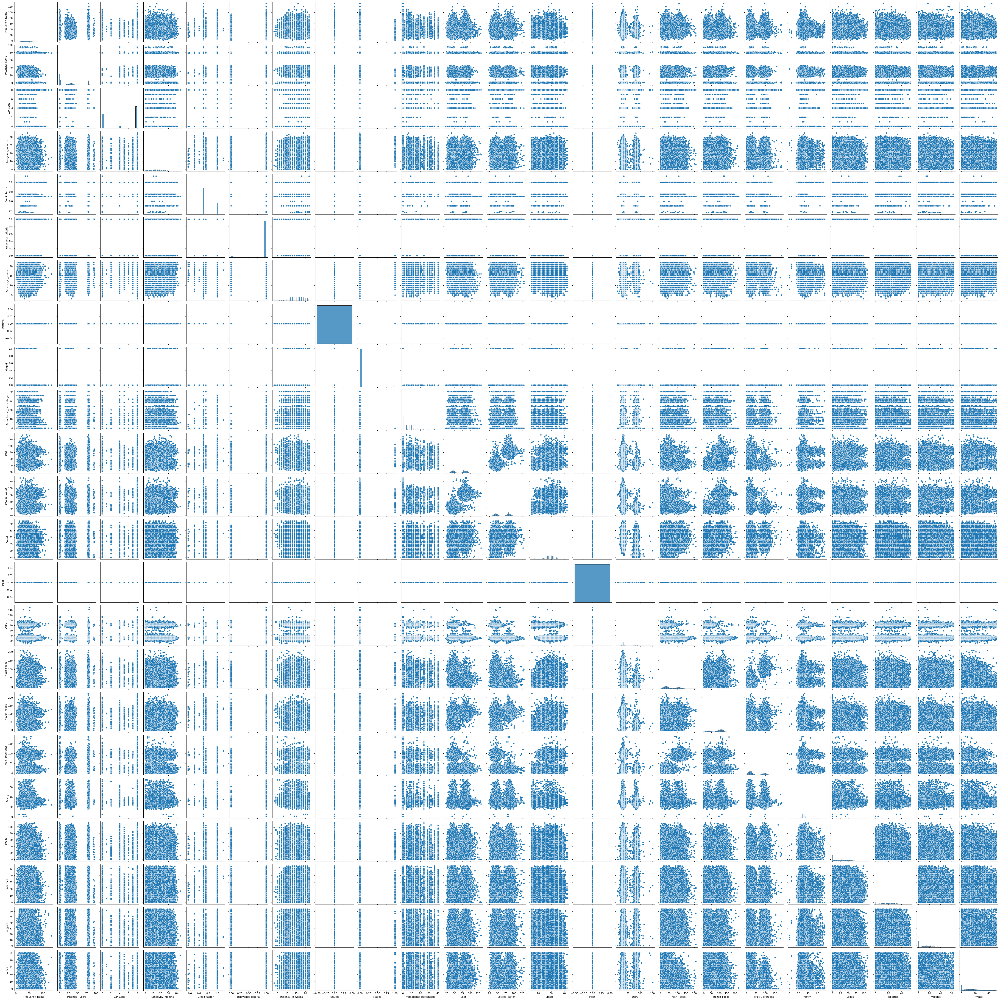

In [36]:
# Select the columns you want to include in the scatter plots
pairplot_columns = ['Frequency_items', 'Potencial_Score', 'ZIP_Code',
       'Longevity_months', 'Credit_factor', 'Relevance_criteria',
       'Recency_in_weeks', 'Returns', 'Flaged', 'Promotional_percentage',
       'Beer', 'Bottled_Water', 'Bread', 'Meat', 'Dairy', 'Fresh_Foods',
       'Frozen_Foods', 'Fruit_Beverages', 'Pastry', 'Sodas', 'Toiletries',
       'Veggies', 'Wines']

# Create a pairplot
sns.pairplot(data_no_outliers_iqr[pairplot_columns])
plt.show()

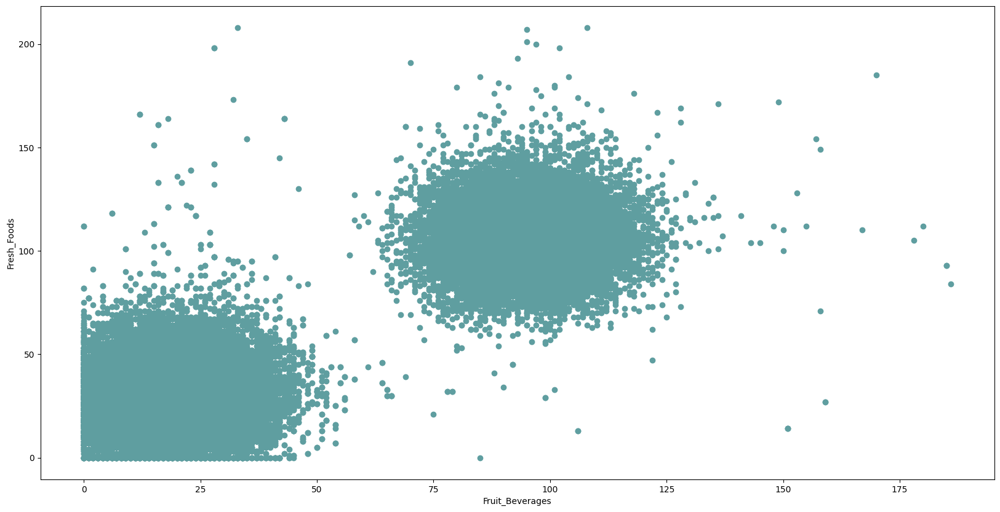

In [38]:
plot_scatter(plt.subplots()[1], data_no_outliers_iqr, 'Fruit_Beverages', 'Fresh_Foods')

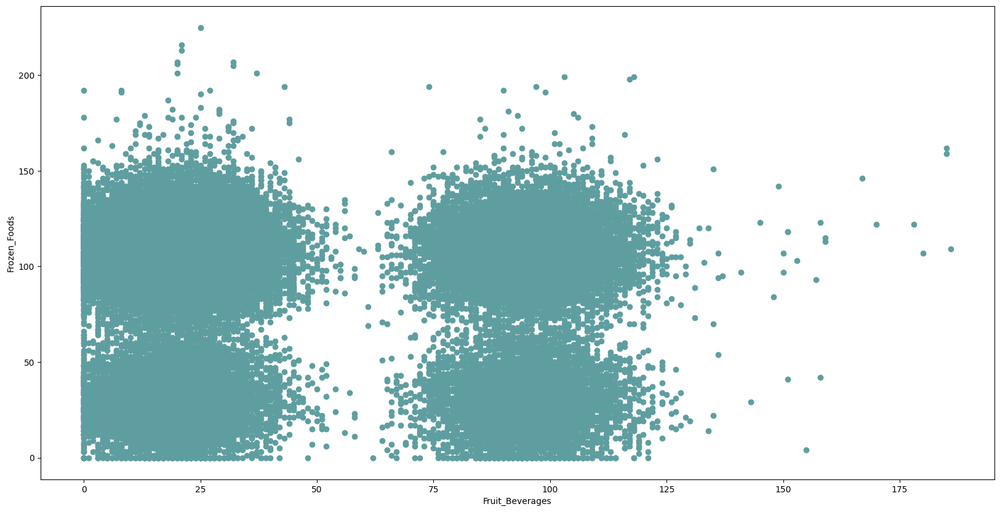

In [39]:
plot_scatter(plt.subplots()[1], data_no_outliers_iqr, 'Fruit_Beverages', 'Frozen_Foods')

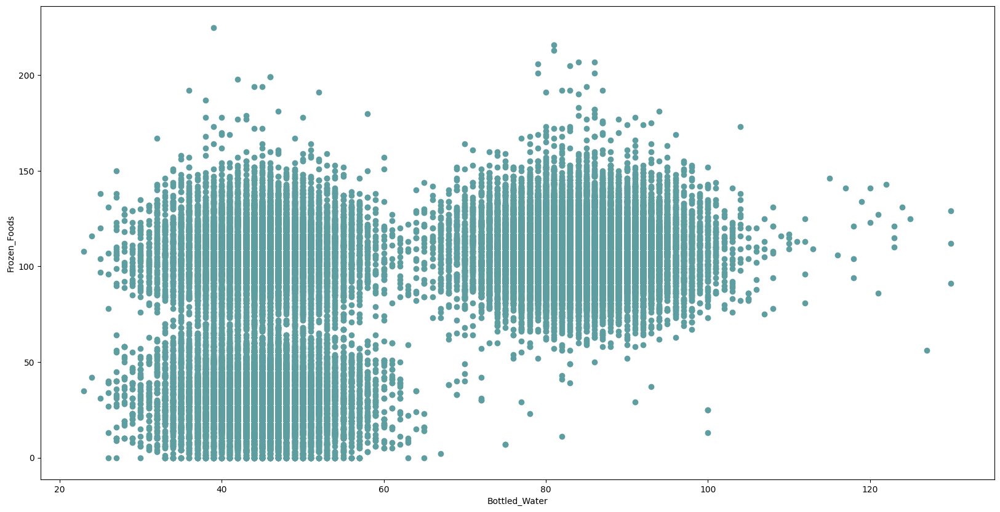

In [40]:
plot_scatter(plt.subplots()[1], data_no_outliers_iqr, 'Bottled_Water', 'Frozen_Foods')

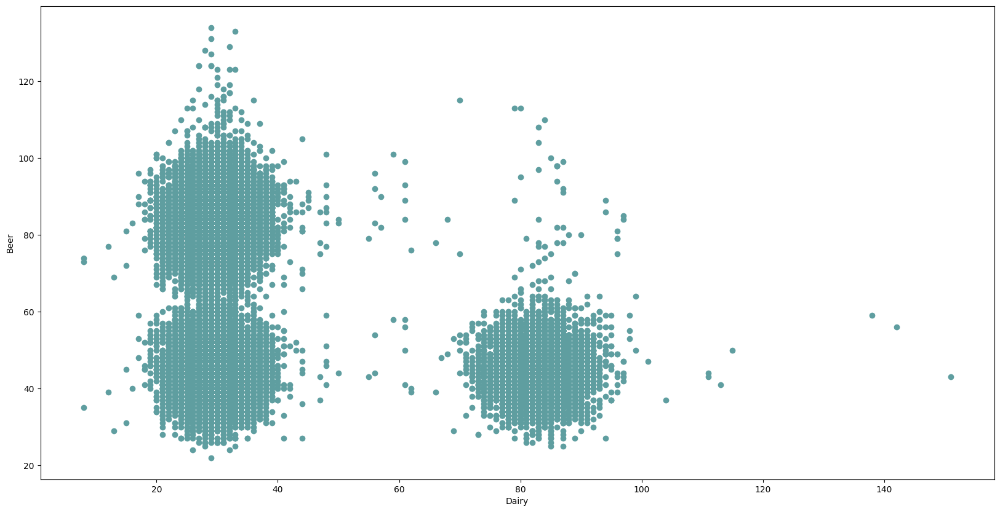

In [43]:
plot_scatter(plt.subplots()[1], data_no_outliers_iqr, 'Dairy', 'Beer')

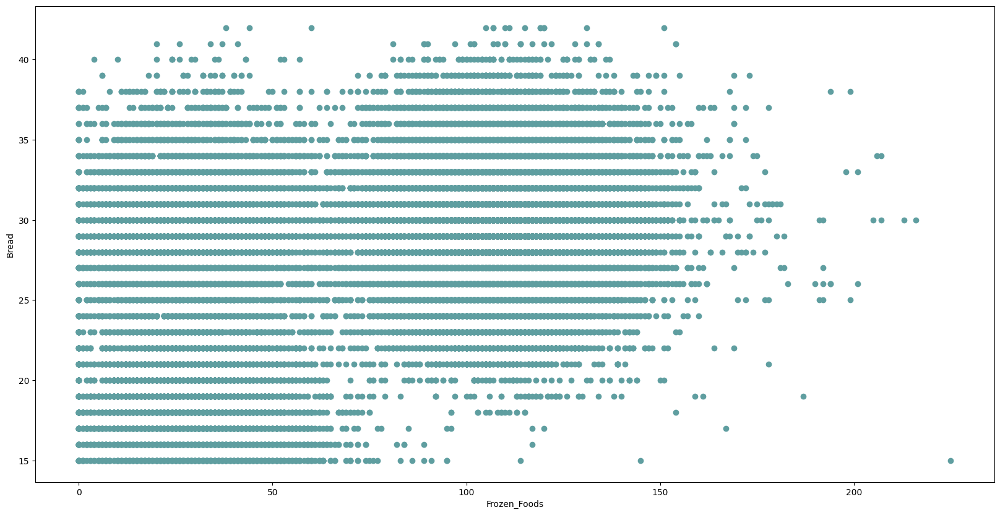

In [50]:
plot_scatter(plt.subplots()[1], data_no_outliers_iqr, 'Frozen_Foods', 'Bread')

# Feature Engineering
<a id='feature-engineering'></a>

### Percentage Amouts Spent

In [101]:

# Calculate the total spend by summing the 'spend' columns across rows
total_spend = data_imputed.loc[:, spent_amounts].sum(axis = 1)

# Calculate the percentage spend for each 'spend' column
for column in spent_amounts:
    # Create a new column name for the percentage spend
    percentage_column = 'Percentage_' + column
    
    # Calculate the percentage spend by dividing the 'spend' column by the total spend
    data_imputed[percentage_column] = data_imputed[column] / total_spend


In [102]:

# Calculate the total spend by summing the 'spend' columns across rows
total_spend = data_no_outliers_iqr.loc[:, spent_amounts].sum(axis = 1)

# Calculate the percentage spend for each 'spend' column
for column in spent_amounts:
    # Create a new column name for the percentage spend
    percentage_column = 'Percentage_' + column
    
    # Calculate the percentage spend by dividing the 'spend' column by the total spend
    data_no_outliers_iqr[percentage_column] = data_no_outliers_iqr[column] / total_spend


# Data Visualization 2
<a id='dataviz2'></a>


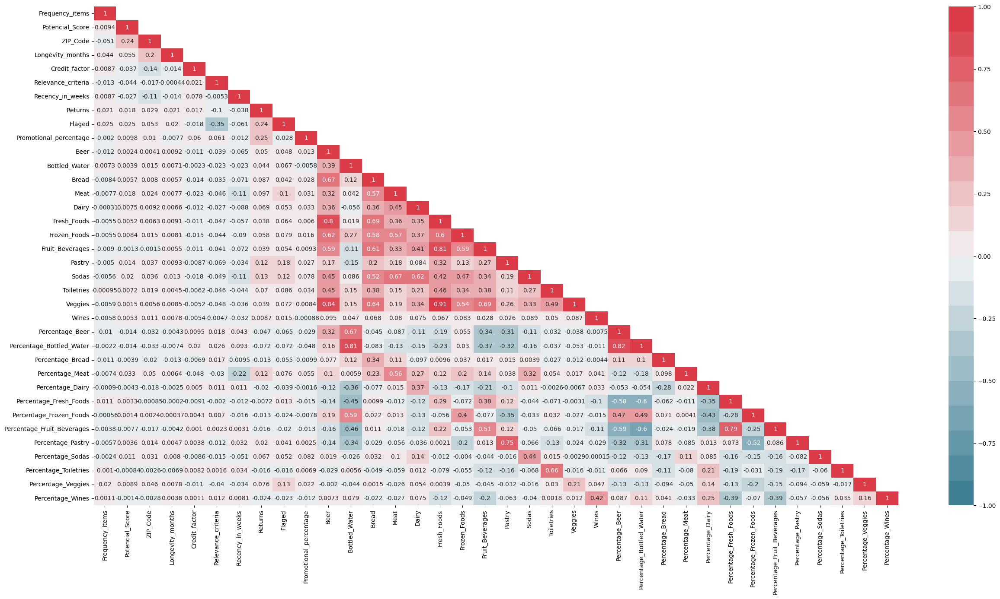

In [103]:
plot_correlation_matrix(data_imputed.iloc[:, 1:], 'pearson')

In [104]:
# Perform standard scaling on the numerical columns
data_no_outliers_iqr_st_scl = StandardScaler().fit_transform(data_no_outliers_iqr.iloc[:, 1:])

# Create a new DataFrame with the scaled values
data_no_outliers_iqr_st_scl = pd.DataFrame(data_no_outliers_iqr_st_scl, columns=data_no_outliers_iqr.iloc[:, 1:].columns, index=data_no_outliers_iqr.index)

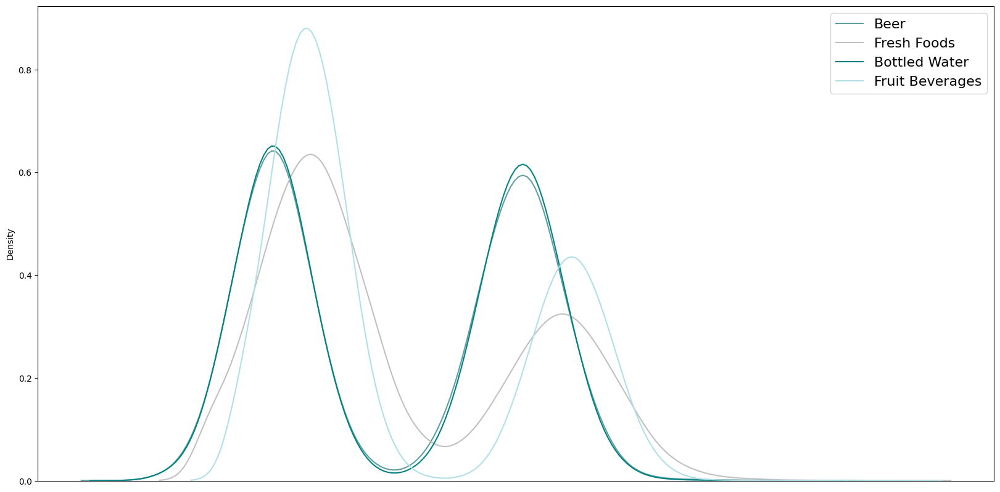

In [123]:
# Create KDE plots for the scaled numerical columns
sns.kdeplot(data_no_outliers_iqr_st_scl.Beer, color='cadetblue')
sns.kdeplot(data_no_outliers_iqr_st_scl.Fresh_Foods, color='silver')
sns.kdeplot(data_no_outliers_iqr_st_scl.Bottled_Water, color='teal')
sns.kdeplot(data_no_outliers_iqr_st_scl.Fruit_Beverages, color='powderblue')

# Set the legend and label the x-axis
plt.legend(['Beer', 'Fresh Foods', 'Bottled Water', 'Fruit Beverages'], fontsize=16)
plt.gca().set_xticks([])
plt.xlabel('')

# Display the plot
plt.show()

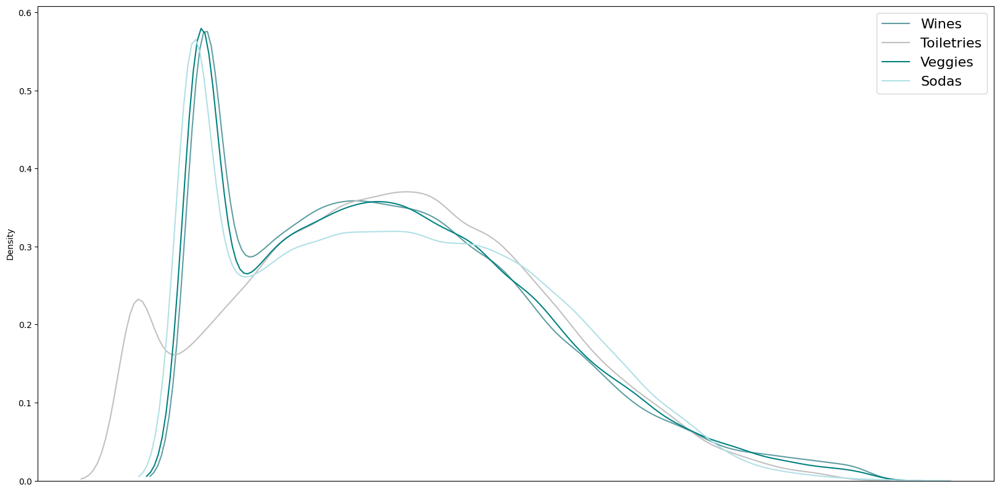

In [127]:
# Create KDE plots for the scaled numerical columns
sns.kdeplot(data_no_outliers_iqr_st_scl.Wines, color='cadetblue')
sns.kdeplot(data_no_outliers_iqr_st_scl.Toiletries, color='silver')
sns.kdeplot(data_no_outliers_iqr_st_scl.Veggies, color='teal')
sns.kdeplot(data_no_outliers_iqr_st_scl.Sodas, color='powderblue')

# Set the legend and label the x-axis
plt.legend(['Wines', 'Toiletries', 'Veggies', 'Sodas'], fontsize=16)
plt.gca().set_xticks([])
plt.xlabel('')

# Display the plot
plt.show()

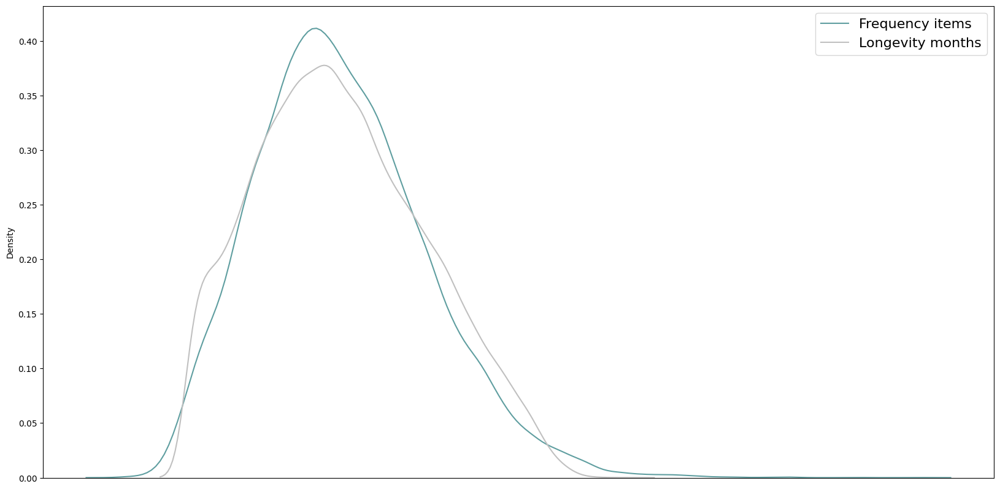

In [120]:
# Create KDE plots for the scaled numerical columns
sns.kdeplot(data_no_outliers_iqr_st_scl.Frequency_items, color='cadetblue')
sns.kdeplot(data_no_outliers_iqr_st_scl.Longevity_months, color='silver')


# Set the legend and label the x-axis
plt.legend(['Frequency items', 'Longevity months'], fontsize=16)
plt.gca().set_xticks([])
plt.xlabel('')

# Display the plot
plt.show()

# Duvidas
<a id='duvidas'></a>

1. Podemos assumir que quem tem null na educação é porque não tem educação?
    - ou podemos imputa-la com base nos IDs?

2. As nossas ultimas rows (297) têm o valor de todas as spent amounts a 0. Podemos apagalas?

3. Relevance Criteria tem valores de 'Unknown', isso pode ser considerado uma categoria, ou eles têm mesmo de pertencer a uma das duas categorias 'Priority' / 'Caution'?

3. Colunas de percentagem (Potencial Score e Credit Factor): Os valores vão mesmo de -100 a 100 (para potencial score) e 0 a 100 (para credit factor) ou é suposto terem sido convertidos para valores de -1 a 1 e 0 a 1, respetivamente?

4. Valores irreais em variaveis calculadas por outros modelos podem ser convertidos para o valor aceitável mais proximo? Por exemplo, para o Potencial Score, podemos assumir que o modelo foi incorretamente feito com uma regressão linear que permite valores acima de 100 e que portanto o valor deveria ser convertido para 100?

5. Os valores da coluna Flagged que são 2, é para por NaN, certo? Não faz sentido converter para 1, ou faz?

6. Valores negativos em categorias de produtos são returns. Ou seja, são valores de compras de 2022 que foram devolvidas em 2023, certo? Ou seja, se eu comprei 20 euros em vinho em 2022 e os devolvi em 2023, considerando que não comprei mais vinho em 2023, o valor dessa categoria fica a -20, certo?

7. Valores negativos da coluna returns são considerados erros, ou têm alguma interpretação?

8. Se tivermos rows com valores negativos em algumas categorias de produtos e 0 na coluna das returns, é uma inconsistência, certo? 

# Mais descobertas ainda não discutidas
<a id='descobertas'></a>

As nossas ultimas 297 linhas (sem contar com a ultima, for some reason) tem todas as spent amounts a 0

In [ ]:
# Calculate the sum of the spent amount columns for each row
data['Spent_Sum'] = data[spent_amounts].sum(axis=1)

# Filter the rows where the sum is 0
rows_with_zero_spent = data[data['Spent_Sum'] == 0]

# Display the filtered rows
rows_with_zero_spent

,Frequency_items,Potencial_Score,Longevity_months,Credit_factor,Relevance_criteria,Recency_in_weeks,Flaged,Promotional_percentage,Beer,Bottled_Water,...,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines,Spent_Sum
123386,55,18.53,NaN,0.7,1.0,17,0.0,10.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123387,36,37.00,28.0,0.7,1.0,13,0.0,6.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123388,50,-0.20,22.0,0.7,1.0,17,0.0,8.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123389,6,79.67,24.0,0.7,1.0,13,0.0,0.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123390,33,21.83,22.0,0.7,1.0,17,0.0,24.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123678,33,79.60,21.0,0.7,1.0,19,0.0,0.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123679,37,0.30,NaN,0.7,1.0,13,0.0,16.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123680,43,79.17,11.0,0.7,1.0,14,0.0,30.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0
123681,75,33.31,31.0,0.7,1.0,21,0.0,0.0,0,0,...,0,0,0.0,0,0,0,0,0,0,0.0


In [ ]:
# Drop the rows where the sum is 0
data = data[data['Spent_Sum'] != 0]

# Extras
<a id='extras'></a>

In [ ]:
# SOMAR OS VALORES NEGATIVOS DOS SPENT AMOUNTS E COLOCAR EM MODULO NA COLUNA RETURNS
# Identify rows where Returns are 0 and there are negative values in any of the spent_amounts
rows_with_neg_values = data[(data['Returns'] == 0) & (data[spent_amounts] < 0).any(axis=1)]

# Iterate over these rows and update the Returns column
for index, row in rows_with_neg_values.iterrows():
    # Sum the negative values, turn it into a positive value
    negative_sum = row[spent_amounts][row[spent_amounts] < 0].sum() * -1
    # Update the Returns column
    data.at[index, 'Returns'] = negative_sum

# Display the updated rows to verify
data.loc[rows_with_neg_values.index, ['Returns'] + spent_amounts]

,Returns,Beer,Bottled_Water,Bread,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
1,12,46,58,14,7,90,134,26.0,20,31,-12,2,18,2
2,19,39,57,17,0,89,39,-6.0,25,32,17,33,26,-13
3,2,50,41,17,0,89,26,66.0,16,29,31,28,-2,8
4,2,43,46,13,0,90,-2,57.0,27,45,46,19,23,9
12,7,51,49,25,0,89,11,38.0,22,33,-7,20,105,68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123370,7,51,48,29,1,100,88,151.0,117,109,124,7,-7,11
123373,6,51,48,29,1,100,88,234.0,109,26,94,20,-6,6
123379,2,39,37,12,6,100,42,50.0,33,25,70,22,-2,31
123383,11,61,48,13,9,100,61,41.0,26,25,27,23,11,-11


# IDs
<a id='ids'></a>

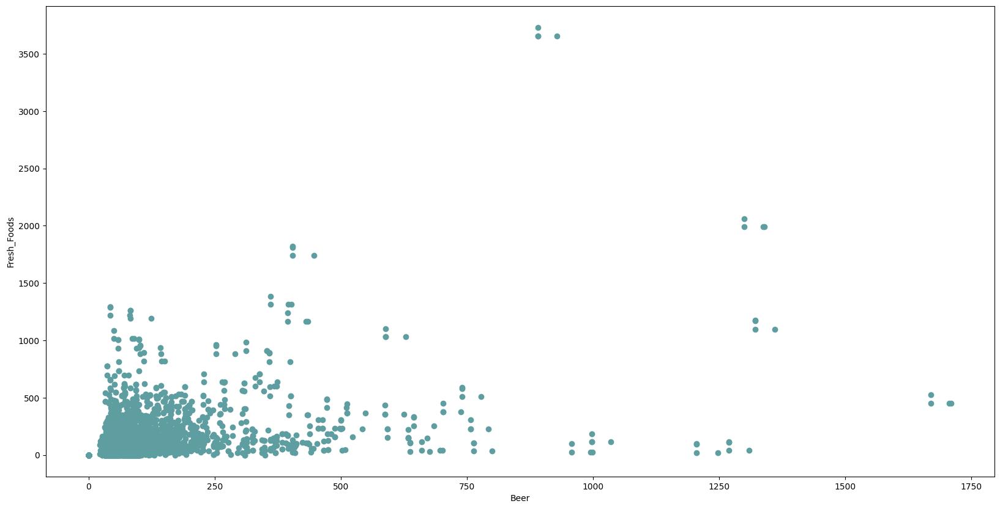

In [ ]:
plot_scatter(plt.subplots()[1], data.drop(data[data['Beer'] > 5000].index), 'Beer', 'Fresh_Foods')

In [ ]:
pd.set_option('display.max_columns', None)
data[(data['Beer'] > 1500) & (data['Beer'] < 1750)]

,ID_Client,Frequency_items,Potencial_Score,Longevity_months,Credit_factor,Relevance_criteria,Recency_in_weeks,Returns,Flaged,Promotional_percentage,Beer,Bottled_Water,Bread,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
3115,10023562SCO9NKID809,54,78.53,18.0,0.7,1.0,7.0,NaN,0.0,32.0,1670,40,144,57,88,450,44.0,36,110,0,29,30,111
42537,10023562SCO9NKID555,59,78.83,26.0,0.7,1.0,7.0,0.0,0.0,32.0,1710,81,144,57,34,450,119.0,36,30,13,34,26,82
42538,10023562SCO9NKID661,59,80.13,20.0,0.7,1.0,4.0,NaN,0.0,32.0,1706,78,144,57,34,450,125.0,36,30,0,21,22,82
42539,10023562SCO9NKID481,43,79.93,14.0,0.7,1.0,0.0,NaN,0.0,32.0,1670,40,144,57,34,524,44.0,113,30,0,20,22,67


In [ ]:
pd.set_option('display.max_columns', None)
data[(data['Fresh_Foods'] > 3000) & (data['Beer'] < 5000)]

,ID_Client,Frequency_items,Potencial_Score,Longevity_months,Credit_factor,Relevance_criteria,Recency_in_weeks,Returns,Flaged,Promotional_percentage,Beer,Bottled_Water,Bread,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
19124,9563830SCA6NKID585,39,77.5,19.0,0.0,0.0,8.0,0.0,1.0,0.0,891,52,1127,6771,82,3654,6988.0,624,1393,4303,95,674,359
89512,9563830SCA6NKID342,32,78.9,20.0,0.0,0.0,5.0,0.0,1.0,0.0,891,52,1138,6771,28,3731,7069.0,704,1393,4303,85,677,360
89513,9563830SCA6NKID633,32,78.6,13.0,0.0,0.0,NaN,0.0,1.0,0.0,928,90,1138,6771,28,3654,7063.0,624,1393,4281,86,677,374
89514,9563830SCA6NKID805,27,78.7,17.0,0.0,0.0,NaN,0.0,1.0,0.0,891,52,1138,6771,28,3654,6988.0,624,1474,4255,2,676,361


In [ ]:
data['NumID'] = data['ID_Client'].str.extract(r'^(\d+)')
data['SeqID'] = data['ID_Client'].str.replace(r'^\d+|\d+$', '', regex=True)
data['RepID'] = data['ID_Client'].str.extract(r'(\d+)$')

In [ ]:
data['NumID'].value_counts()

NumID
10153360    8
9337686     4
10557943    4
10223386    4
10468039    4
           ..
917998      2
10359812    2
99830       2
9437209     2
9561327     2
Name: count, Length: 31056, dtype: int64

There are groups of 2, 3 and 4 replicas. There is just one case in which, for some reason there are 8 (but it is 2 groups of 4)

### Check if filling missing values with NumID is an option

For Education:

In [ ]:
# Group by NumID and check unique values of Education
educ_check = data.groupby('NumID')['Education'].apply(lambda x: x.dropna().unique())

# Filter groups with more than one unique value
ambiguous_educ = educ_check[educ_check.apply(lambda x: len(x) > 1)]

# Display the ambiguous groups
print("Groups with ambiguous Education values:")
ambiguous_educ

Groups with ambiguous Education values:


NumID
10153360    [1.0, 4.0]
Name: Education, dtype: object

There is just one value in which there is more than one value of education inside a group of datapoints with the same NumID (it is the one that has 8 datapoints). So, it is possible!

For Gender:

In [ ]:
# Group by NumID and check unique values of Gender
gender_check = data.groupby('NumID')['Gender'].apply(lambda x: x.dropna().unique())

# Filter groups with more than one unique value
ambiguous_gender = gender_check[gender_check.apply(lambda x: len(x) > 1)]

# Display the ambiguous groups
print("Groups with ambiguous Gender values:")
ambiguous_gender

Groups with ambiguous Gender values:


NumID
100036      [1.0, 0.0]
100093      [1.0, 0.0]
10011423    [0.0, 1.0]
10011756    [0.0, 1.0]
10012552    [0.0, 1.0]
               ...    
9974040     [0.0, 1.0]
99772       [1.0, 0.0]
998622      [1.0, 0.0]
998865      [1.0, 0.0]
999721      [0.0, 1.0]
Name: Gender, Length: 4744, dtype: object

There are many values with ambiguity. We can not derive anything for certain based on NumID.